In [1]:
# !export

#### Module installs

In [2]:
# !pip3 install git+https://github.com/plamere/spotipy.git --upgrade
# !pip3 install image
# !pip3 install Send2Trash

#### Imports

In [3]:
import spotipy
import spotipy.util as util
from spotipy.oauth2 import SpotifyClientCredentials

import os
import urllib.request

%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from PIL import Image

import requests
from io import BytesIO
import boto3

#### Spotipy set up

In [4]:
client_id = os.environ['SPOTIFY_CLIENT_ID']
client_secret = os.environ['SPOTIFY_CLIENT_SECRET']
redirect_URI = os.environ['SPOTIFY_REDIRECT_URI']
username = os.environ['SPOTIFY_USERNAME']

client_credentials_manager = SpotifyClientCredentials(client_id=client_id, client_secret=client_secret)
sp = spotipy.Spotify(client_credentials_manager=client_credentials_manager)

scope = 'user-library-read user-read-currently-playing user-read-playback-state user-read-recently-played'
token = util.prompt_for_user_token(username, scope, client_id, client_secret, redirect_URI)

if token:
    sp = spotipy.Spotify(auth=token)
else:
    print("Can't get token for", username)

In [5]:
# usually takes some time to execute...

url_list = []

c = 25
r = 9
limit = c
amount = c*r*2

for i in range(0, amount, limit):
    saved_tracks = sp.current_user_saved_tracks(limit=limit, offset=i)
    
    for t in saved_tracks['items']:
        track = t['track']
        track_album = track['album']
        url = track_album['images'][0]['url']
        url_dict = {
            'id': track_album['id'],
            'name': track_album['name'],
            'url': url
        }
        url_list.append(url_dict)
        
    print('Progress: '+str(i+limit)+'/'+str(amount), end='\r')

In [6]:
df = pd.DataFrame(url_list)
df.drop_duplicates(keep='first', inplace=True) # drop duplicate albums
df.reset_index(inplace=True)
df.drop('index', axis=1, inplace=True)
df.head()

,id,name,url
0,0mw0v424Ribwwrt0oMVB1j,Warriorz,https://i.scdn.co/image/ab67616d0000b27399d5e1...
1,2hKCg2JLGtjATrYvpQedT5,Simon Says,https://i.scdn.co/image/ab67616d0000b2730110f5...
2,28yHV3Gdg30AiB8h8em1eW,Appetite For Destruction,https://i.scdn.co/image/ab67616d0000b27321ebf4...
3,4E7bV0pzG0LciBSWTszra6,X&Y,https://i.scdn.co/image/ab67616d0000b2735f8646...
4,2ve4UJ1zCwdLlFfGJhuq6f,First Bloom,https://i.scdn.co/image/ab67616d0000b27353a428...


In [7]:
df.shape

(401, 3)

In [8]:
# usually takes some time to execute...

# create files for images

s3 = boto3.resource('s3')
bucket_name = 'test4855'
img_folder_name = 'collage-images'

cutoff = r * c

for index, row in df.iterrows():
    url = row['url']
    name = str(index+1)
    x = 'img.jpeg'
    urllib.request.urlretrieve(url, x)
    data = open(x, 'rb')
    s3.Bucket(bucket_name).put_object(Key=img_folder_name + '/' + name + '.jpeg', Body=data)

    print(name+'/'+str(cutoff)+' files added.', end='\r')
    
    res = (index + 1) % cutoff
    if res == 0:
        break;

In [9]:
def collage(array, ncols=20):
    nindex, height, width, intensity = array.shape
    nrows = nindex//ncols
    assert nindex == nrows*ncols
    result = (
        array
        .reshape(nrows, ncols, height, width, intensity)
        .swapaxes(1, 2)
        .reshape(height*nrows, width*ncols, intensity)
    )
    return result
    
def make_array():
    l = []
    
    s3 = boto3.resource('s3')
    bucket = s3.Bucket(bucket_name)
    for count, bucket_object in enumerate(bucket.objects.all()):
        if count==0:
            continue
        else:
            print(bucket_object)
            key = bucket_object.key
            location = boto3.client('s3').get_bucket_location(Bucket=bucket_name)['LocationConstraint']
            url = "https://s3-%s.amazonaws.com/%s/%s" % (location, bucket_name, key)
            if '.jpeg' in url:
                response = requests.get(url)
                im = Image.open(BytesIO(response.content)).convert('RGB')
                if im.size == (640, 640):
                    l.append(url)

    l = l[:200]
    
    return np.array([np.asarray(Image.open(BytesIO(requests.get(url).content)).convert('RGB')) for url in l])

arr = make_array()
print('shape', arr.shape)

s3.ObjectSummary(bucket_name='test4855', key='collage-images/1.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/10.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/100.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/101.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/102.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/103.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/104.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/105.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/106.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/107.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/108.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/109.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/11.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/110.jpe

s3.ObjectSummary(bucket_name='test4855', key='collage-images/201.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/202.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/203.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/204.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/205.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/206.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/207.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/208.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/209.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/21.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/210.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/211.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/212.jpeg')
s3.ObjectSummary(bucket_name='test4855', key='collage-images/213.

In [10]:
# usually takes some time to execute...
result = collage(arr)

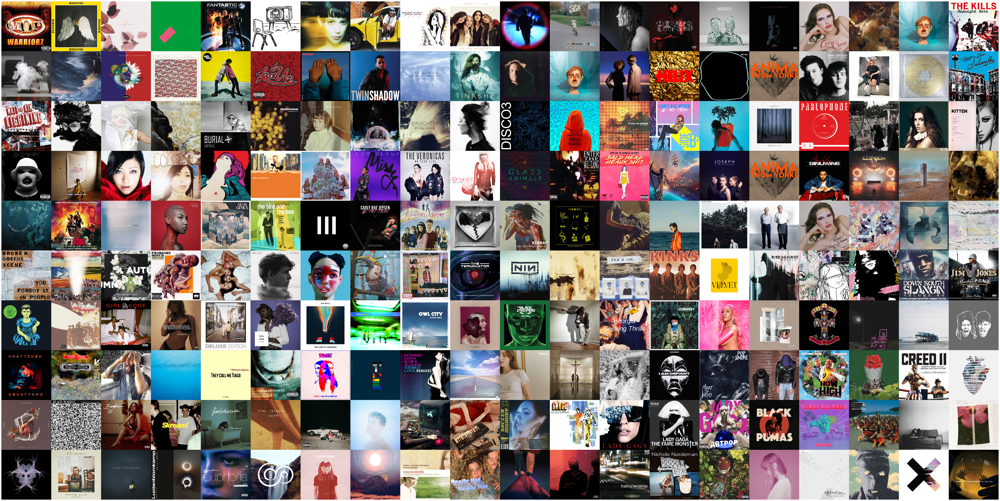

In [11]:
# usually takes some time to execute...

# set figure size
s = 70
plt.figure(figsize=(s,s))

# show result for plot
plt.imshow(result)

# get rid of axes
plt.axis('off')

# save file with no white padding
plt.gca().set_axis_off()
plt.subplots_adjust(
    top = 1,
    bottom = 0,
    right = 1,
    left = 0, 
    hspace = 0,
    wspace = 0
)
plt.margins(0,0)
plt.gca().xaxis.set_major_locator(plt.NullLocator())
plt.gca().yaxis.set_major_locator(plt.NullLocator())
plt.savefig(
    "collage.jpeg",
    bbox_inches = 'tight',
    pad_inches = 0
)